In [1]:
!apt-get update
!apt-get install -y ffmpeg git
print("ffmpeg and git installed successfully.")

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [2,143 kB]
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:8 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Get:10 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Get:11 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-updates/universe amd64 Packages [1,595 kB]
Get:13 https://r2u.stat.illinois.edu/ubu

## Download Separated Audio Files

### Subtask:
Compress the `separated_audio` folder and provide a download link.

In [44]:
import shutil
from google.colab import files

output_zip_name = 'separated_audio_htdemucs_ft_optimized.zip'
output_dir = 'separated_audio/'

# Create a zip archive of the separated_audio folder
shutil.make_archive(output_zip_name.replace('.zip', ''), 'zip', output_dir)

print(f"'{output_zip_name}' created successfully. Now downloading...")

# Download the zip file
files.download(output_zip_name)

'separated_audio_htdemucs_ft_optimized.zip' created successfully. Now downloading...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [5]:
import sys
!apt-get update
!apt-get install -y build-essential libavformat-dev libavcodec-dev libavdevice-dev libavfilter-dev libswresample-dev libswscale-dev
print("System build dependencies for audio/video processing installed successfully.")


Hit:1 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:3 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:4 https://cli.github.com/packages stable InRelease
Hit:5 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:6 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:7 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Hit:11 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Reading package lists... Done
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Reading packag

In [22]:
import sys
!{sys.executable} -m pip install numpy==1.26.4 torch==2.2.0 torchaudio==2.2.0 demucs==4.0.1 faster-whisper==0.10.0 diffq --force-reinstall
print("All Python packages installed successfully with updated numpy version and diffq.")

  Using cached numpy-1.26.4-cp312-cp312-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (61 kB)
  Using cached torch-2.2.0-cp312-cp312-manylinux1_x86_64.whl.metadata (25 kB)
  Using cached torchaudio-2.2.0-cp312-cp312-manylinux1_x86_64.whl.metadata (6.4 kB)
  Using cached demucs-4.0.1-py3-none-any.whl
  Using cached faster_whisper-0.10.0-py3-none-any.whl.metadata (14 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 157.1/157.1 kB 9.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached filelock-3.20.0-py3-none-any.whl.metadata (2.1 kB)
  Using cached typing_extensions-4.15.0-py3-none-any.whl.metadata (3.3 kB)
  Using cached sympy-1.14.0-py3-none-any.whl.metadata (12 kB)
  Using cached networkx-3.5-py3-none-any.whl.metadata (6.3 kB)
  Using cached jinja2-3.1.6-py3-none-any.whl.metadata (2.9 kB)
  Using cached fsspec-2025.10.0-py3-none-any.whl.metadata (10 kB)
  Using

In [8]:
!ls -F

sample_data/  text_batched_generated.wav


In [10]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import soundfile as sf
import os

# --- Ayarlar ---
FILE_PATH = "text_batched_generated.wav"

# --- 1. Ses Dosyasını Yükle ve Bilgileri Yazdır ---
try:
    # Sesi librosa ile yükle, orijinal örnekleme hızını (sr=None) ve kanalları (mono=False) koru
    y, sr = librosa.load(FILE_PATH, sr=None, mono=False)

    # Temel bilgileri yazdır
    print(f"--- Orijinal Ses Dosyası Analizi ---")
    print(f"Dosya Yolu: {FILE_PATH}")
    print(f"Örnekleme Hızı (Sample Rate): {sr} Hz")

    # Kanal sayısını ve şeklini kontrol et
    channels = 1
    if y.ndim > 1:
        channels = y.shape[0]
        print(f"Kanal Sayısı: {channels} (Stereo)")
        print(f"Sinyal Şekli (shape): {y.shape} -> (kanal, örneklem)")
    else:
        print(f"Kanal Sayısı: {channels} (Mono)")
        print(f"Sinyal Şekli (shape): {y.shape} -> (örneklem,)")

    duration = librosa.get_duration(y=y, sr=sr)
    print(f"Süre: {duration:.2f} saniye")

except FileNotFoundError:
    print(f"HATA: '{FILE_PATH}' dosyası bulunamadı. Lütfen dosyayı Jupyter Notebook dizinine kopyalayın.")
    # Bu hücrenin geri kalanının çalışmasını engelle
    raise

# --- 2. Görselleştirme için Sinyali Hazırla ---
# Görselleştirmeler için (özel)

--- Orijinal Ses Dosyası Analizi ---
Dosya Yolu: text_batched_generated.wav
Örnekleme Hızı (Sample Rate): 24000 Hz
Kanal Sayısı: 1 (Mono)
Sinyal Şekli (shape): (1904000,) -> (örneklem,)
Süre: 79.33 saniye


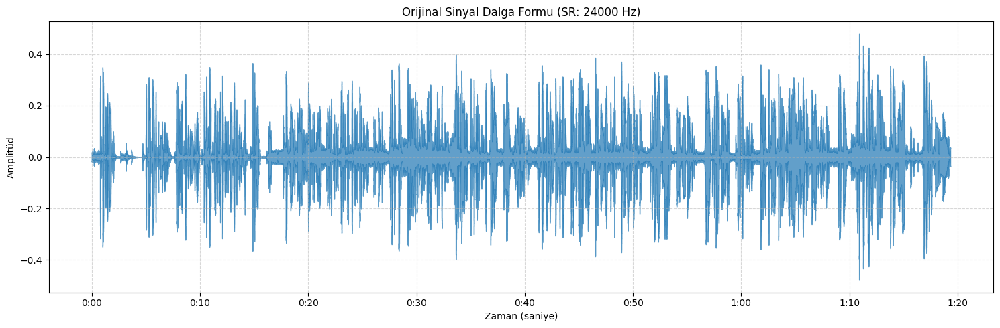

In [11]:
# --- 3. Dalga Formunu Görselleştir (Stereo ise ikisini de gösterir) ---
plt.figure(figsize=(15, 5))
# librosa.display.waveshow, stereo sinyali otomatik olarak iki kanal için çizer
librosa.display.waveshow(y, sr=sr, alpha=0.7)
plt.title(f'Orijinal Sinyal Dalga Formu (SR: {sr} Hz)')
plt.xlabel('Zaman (saniye)')
plt.ylabel('Amplitüd')
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

In [29]:
# Use demucs to separate speech and music with specified parameters for potentially higher quality
# The -o flag specifies the output directory
# The -n flag specifies the model to use (htdemucs_ft is specified)
# --shifts=5 processes the audio multiple times with small shifts, averaging results for better quality
# --segment 7 specifies the segment length for processing
print(f"Starting re-separation of {FILE_PATH} with htdemucs_ft model, shifts=5, and segment=7...")
!demucs "{FILE_PATH}" -o separated_audio --name htdemucs_ft --shifts=115
print("Re-separation complete. Check the 'separated_audio' directory for new results from htdemucs_ft with updated parameters.")

Starting re-separation of text_batched_generated.wav with htdemucs_ft model, shifts=5, and segment=7...
Selected model is a bag of 4 models. You will see that many progress bars per track.
Separated tracks will be stored in /content/separated_audio/htdemucs_ft
Separating track text_batched_generated.wav
100%|████████████████████████████████████████████████| 81.89999999999999/81.89999999999999 [00:03<00:00, 23.84seconds/s]
100%|████████████████████████████████████████████████| 81.89999999999999/81.89999999999999 [00:01<00:00, 58.99seconds/s]
100%|████████████████████████████████████████████████| 81.89999999999999/81.89999999999999 [00:01<00:00, 58.54seconds/s]
100%|████████████████████████████████████████████████| 81.89999999999999/81.89999999999999 [00:01<00:00, 58.28seconds/s]
100%|████████████████████████████████████████████████| 81.89999999999999/81.89999999999999 [00:01<00:00, 58.90seconds/s]
100%|████████████████████████████████████████████████| 81.89999999999999/81.89999999999999

In [30]:
import torch

if torch.cuda.is_available():
    print(f"CUDA is available. GPU device name: {torch.cuda.get_device_name(0)}")
    print(f"Total GPU memory: {torch.cuda.get_device_properties(0).total_memory / (1024**3):.2f} GB")
else:
    print("CUDA is NOT available. Demucs might be running on CPU.")

CUDA is available. GPU device name: NVIDIA A100-SXM4-80GB
Total GPU memory: 79.32 GB


In [34]:
!demucs "{FILE_PATH}" -o separated_audio --name htdemucs_ft --shifts=100 --segment 7

Selected model is a bag of 4 models. You will see that many progress bars per track.
Separated tracks will be stored in /content/separated_audio/htdemucs_ft
Separating track text_batched_generated.wav
100%|██████████████████████████████████████████████████████████████████████████| 84.0/84.0 [00:03<00:00, 22.94seconds/s]
100%|██████████████████████████████████████████████████████████████████████████| 84.0/84.0 [00:01<00:00, 53.15seconds/s]
100%|██████████████████████████████████████████████████████████████████████████| 84.0/84.0 [00:01<00:00, 53.23seconds/s]
100%|██████████████████████████████████████████████████████████████████████████| 84.0/84.0 [00:01<00:00, 53.21seconds/s]
100%|██████████████████████████████████████████████████████████████████████████| 84.0/84.0 [00:01<00:00, 53.15seconds/s]
100%|██████████████████████████████████████████████████████████████████████████| 84.0/84.0 [00:01<00:00, 53.23seconds/s]
100%|████████████████████████████████████████████████████████████████████

In [40]:
!demucs "{FILE_PATH}" -o separated_audio --name htdemucs_ft --shifts=100 --segment 7 --overlap=0.95

Selected model is a bag of 4 models. You will see that many progress bars per track.
Separated tracks will be stored in /content/separated_audio/htdemucs_ft
Separating track text_batched_generated.wav
100%|████████████████████████████████████████████████| 79.44999999999999/79.44999999999999 [00:24<00:00,  3.24seconds/s]
100%|██████████████████████████████████████████████████████████████████████████| 79.8/79.8 [00:22<00:00,  3.54seconds/s]
100%|████████████████████████████████████████████████| 79.44999999999999/79.44999999999999 [00:22<00:00,  3.54seconds/s]
100%|████████████████████████████████████████████████| 79.44999999999999/79.44999999999999 [00:22<00:00,  3.54seconds/s]
100%|██████████████████████████████████████████████████████████████████████████| 79.8/79.8 [00:22<00:00,  3.54seconds/s]
100%|██████████████████████████████████████████████████████████████████████████| 79.8/79.8 [00:22<00:00,  3.54seconds/s]
100%|████████████████████████████████████████████████████████████████████

In [37]:
print("Checking the contents of the 'htdemucs_ft' directory after the last run:")
!ls -F separated_audio/htdemucs_ft/text_batched_generated/

Checking the contents of the 'htdemucs_ft' directory after the last run:
bass.wav  drums.wav  other.wav	vocals.wav


In [41]:
from IPython.display import Audio
import os
import soundfile as sf

# Define paths to the new separated files from htdemucs_ft with optimized parameters
separated_dir_htdemucs_ft_new = "separated_audio/htdemucs_ft/text_batched_generated/"
vocals_path_htdemucs_ft_new = os.path.join(separated_dir_htdemucs_ft_new, "vocals.wav")
bass_path_htdemucs_ft_new = os.path.join(separated_dir_htdemucs_ft_new, "bass.wav")
drums_path_htdemucs_ft_new = os.path.join(separated_dir_htdemucs_ft_new, "drums.wav")
other_path_htdemucs_ft_new = os.path.join(separated_dir_htdemucs_ft_new, "other.wav")

# Reconstruct music track for listening from htdemucs_ft outputs
try:
    # Load components to ensure consistent sample rate and length
    y_vocals_htdemucs_ft_new, sr_htdemucs_ft_new = sf.read(vocals_path_htdemucs_ft_new)
    y_bass_htdemucs_ft_new, _ = sf.read(bass_path_htdemucs_ft_new)
    y_drums_htdemucs_ft_new, _ = sf.read(drums_path_htdemucs_ft_new)
    y_other_htdemucs_ft_new, _ = sf.read(other_path_htdemucs_ft_new)

    min_len_htdemucs_ft_new = min(len(y_bass_htdemucs_ft_new), len(y_drums_htdemucs_ft_new), len(y_other_htdemucs_ft_new))
    y_music_combined_htdemucs_ft_new = y_bass_htdemucs_ft_new[:min_len_htdemucs_ft_new] + y_drums_htdemucs_ft_new[:min_len_htdemucs_ft_new] + y_other_htdemucs_ft_new[:min_len_htdemucs_ft_new]

    # Save the combined music track to a temporary file for playback
    music_combined_path_htdemucs_ft_new = os.path.join(separated_dir_htdemucs_ft_new, "music_combined_optimized.wav")
    sf.write(music_combined_path_htdemucs_ft_new, y_music_combined_htdemucs_ft_new, sr_htdemucs_ft_new)

    print("Playing Original Audio (for comparison):")
    display(Audio(FILE_PATH))

    print("Playing NEW Separated Vocals (Speech) from htdemucs_ft with optimized parameters:")
    display(Audio(vocals_path_htdemucs_ft_new))

    print("Playing NEW Separated Music (Bass + Drums + Other) from htdemucs_ft with optimized parameters:")
    display(Audio(music_combined_path_htdemucs_ft_new))

    print("Please listen to these new tracks and provide your feedback on the separation quality.")
except FileNotFoundError as e:
    print(f"Error loading htdemucs_ft separated tracks: {e}. Make sure the paths are correct.")
except Exception as e:
    print(f"An error occurred during htdemucs_ft audio processing: {e}")

Playing Original Audio (for comparison):


Playing NEW Separated Vocals (Speech) from htdemucs_ft with optimized parameters:


Playing NEW Separated Music (Bass + Drums + Other) from htdemucs_ft with optimized parameters:


Please listen to these new tracks and provide your feedback on the separation quality.


New separated tracks loaded successfully from htdemucs_ft with optimized parameters.


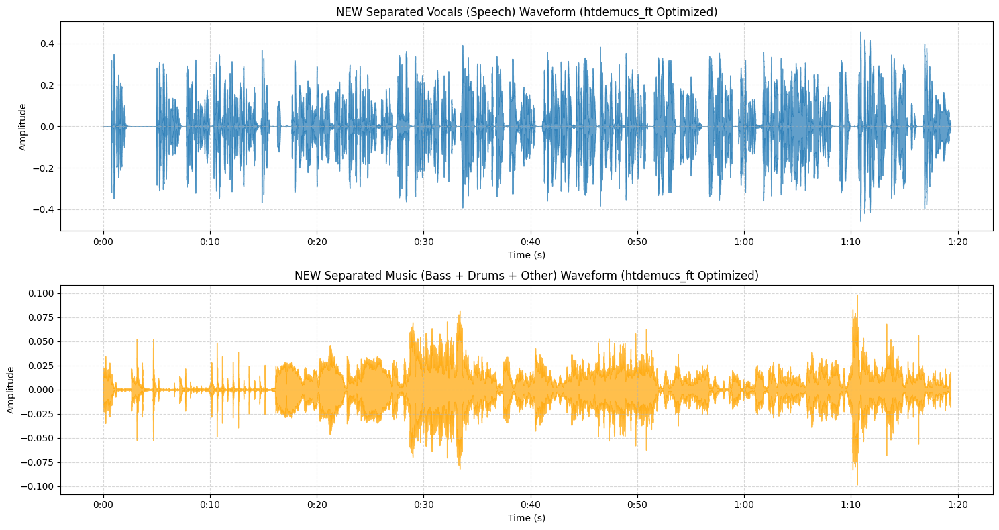

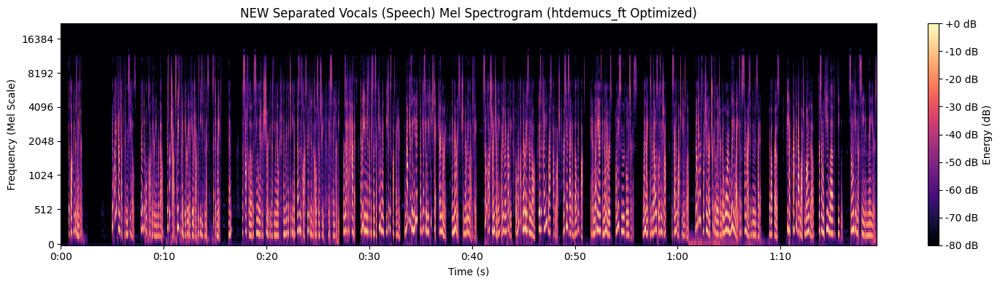

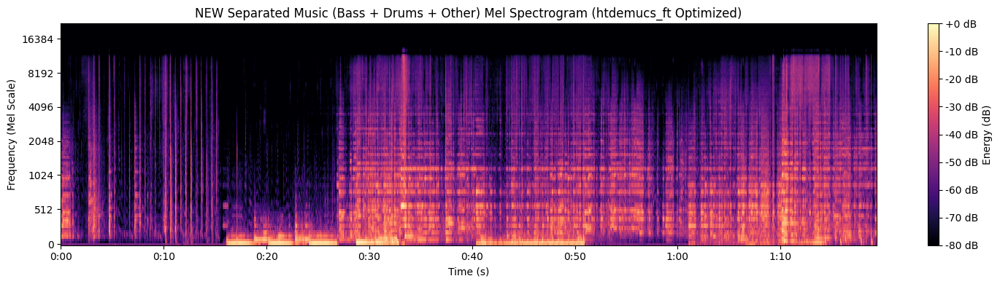

Visual inspection of new separated tracks complete. Please review the generated plots.


In [42]:
import os
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np

# Define paths to the new separated files from htdemucs_ft with optimized parameters
separated_dir_new = "separated_audio/htdemucs_ft/text_batched_generated/"
vocals_path_new = os.path.join(separated_dir_new, "vocals.wav")
bass_path_new = os.path.join(separated_dir_new, "bass.wav")
drums_path_new = os.path.join(separated_dir_new, "drums.wav")
other_path_new = os.path.join(separated_dir_new, "other.wav")

# Load new separated tracks
try:
    y_vocals_new, sr_new = librosa.load(vocals_path_new, sr=None, mono=True)
    y_bass_new, _ = librosa.load(bass_path_new, sr=None, mono=True)
    y_drums_new, _ = librosa.load(drums_path_new, sr=None, mono=True)
    y_other_new, _ = librosa.load(other_path_new, sr=None, mono=True)
    print("New separated tracks loaded successfully from htdemucs_ft with optimized parameters.")
except FileNotFoundError as e:
    print(f"Error loading new separated tracks: {e}. Make sure the paths are correct.")
    raise

# Combine music components for analysis (bass, drums, other)
y_music_new = y_bass_new + y_drums_new + y_other_new

# --- Visual inspection of new separated tracks (Waveform) ---
plt.figure(figsize=(15, 8))

plt.subplot(2, 1, 1)
librosa.display.waveshow(y_vocals_new, sr=sr_new, alpha=0.7)
plt.title('NEW Separated Vocals (Speech) Waveform (htdemucs_ft Optimized)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.grid(True, linestyle='--', alpha=0.5)

plt.subplot(2, 1, 2)
librosa.display.waveshow(y_music_new, sr=sr_new, alpha=0.7, color='orange')
plt.title('NEW Separated Music (Bass + Drums + Other) Waveform (htdemucs_ft Optimized)')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

# --- Visual inspection of new separated tracks (Mel Spectrogram) ---
def plot_mel_spectrogram(y_signal, sr_signal, title):
    S_mel = librosa.feature.melspectrogram(y=y_signal, sr=sr_signal, n_mels=128)
    S_mel_db = librosa.power_to_db(S_mel, ref=np.max)
    plt.figure(figsize=(15, 4))
    librosa.display.specshow(S_mel_db, sr=sr_signal, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB', label='Energy (dB)')
    plt.title(title)
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Mel Scale)')
    plt.tight_layout()
    plt.show()

plot_mel_spectrogram(y_vocals_new, sr_new, 'NEW Separated Vocals (Speech) Mel Spectrogram (htdemucs_ft Optimized)')
plot_mel_spectrogram(y_music_new, sr_new, 'NEW Separated Music (Bass + Drums + Other) Mel Spectrogram (htdemucs_ft Optimized)')

print("Visual inspection of new separated tracks complete. Please review the generated plots.")